In [86]:
# nbi:hide_in
from tslearn.metrics import dtw
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch
import numpy
import datetime
from ecoscada import Measurement, GateTime, Cug, Building, BuildingProperty
from ecoscada import Api
from forecasting.data_sources import EcoScadaDS
import cufflinks as cf
cf.go_offline()

In [69]:
#-- how do we automate getting the right buildings
def get_data(cug, target_measurement):
    all_buildings = Api().get_cug_buildings(Cug.get_by_name('Eemnes').guid)

    target_guids= {}
    for i in range(len(all_buildings)):
        if (len(all_buildings[i]['name']) <=8) & (all_buildings[i]['name'][:6] == "Eemnes"):
            for measurements in Api().get_building_measurements(all_buildings[i]['guid']):
                if measurements['name'] == 'grid.active_energy.balance_total':
                    target_guids[all_buildings[i]['name']] = measurements['guid']
                    
#     forecast_guids= {}
#     for i in range(len(all_buildings)):
#         if (len(all_buildings[i]['name']) <=8) & (all_buildings[i]['name'][:6] == "Eemnes"):
#             for measurements in Api().get_building_measurements(all_buildings[i]['guid']):
#                 if measurements['name'] == 'grid.forecast.active_energy.balance_total':
#                     forecast_guids[all_buildings[i]['name']] = measurements['guid']
                    
    columns = list(target_guids.keys())
    df = pd.DataFrame()
    
    end = pd.to_datetime(datetime.datetime.now().strftime('%Y-%m-%d %H')) - datetime.timedelta(days=1)
    start = end-datetime.timedelta(days=92)
    freq = "15T"
    counter = 1

    for col in columns:
        ecoscada_ds = EcoScadaDS(measurement_id=target_guids[col])
#         ecoscada_ds.get_data(start=start, end=end, freq=freq)
        if counter == 1:
            df['ds'] = ecoscada_ds.get_data(start=start, end=end, freq=freq)['ds']
            df[col] = ecoscada_ds.get_data(start=start, end=end, freq=freq)['y']
        else:
            other = ecoscada_ds.get_data(start=start, end=end, freq=freq)
            other = other.rename(columns={"y": col})
            df = df.join(other.set_index('ds'), on='ds')
        counter = counter +1
    
    df = df.set_index(pd.to_datetime(df['ds']))
    df = df.drop(columns=['ds'])
    
    return df

In [70]:
def visualize_missing_data(df):    
    fig = px.imshow(df)
    fig.update_layout(title= 'Missing Values Analysis')
    fig.show()

In [71]:
def fill_missing_value(df, value):
    return df.fillna(value)

In [72]:
def dtw_scores(timeseries_df):
    scores_lists = {}

    for i in timeseries_df.columns:
        scores= []
        for j in timeseries_df.columns:
            scores.append(dtw(timeseries_df[i], timeseries_df[j]))
        scores_lists[i]= scores
        
    scores = pd.DataFrame(scores_lists, index = timeseries_df.columns)

    return scores

In [73]:
def scores_implot(scores):
    fig, ax = plt.subplots(figsize=(12,12))
    im = ax.imshow(scores)

    # We want to show all ticks...
    ax.set_xticks(np.arange(len(scores.columns)))
    ax.set_yticks(np.arange(len(scores.index)))
    # ... and label them with the respective list entries
    ax.set_xticklabels(scores.columns)
    ax.set_yticklabels(scores.index)

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
          rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    for i in range(len(scores.index)):
          for j in range(len(scores.columns)):
                  text = ax.text(j, i, round(scores[scores.columns[j]][scores.index[i]],2),
                            ha="center", va="center", color="w")

    ax.set_title('DTW Scores')
    fig.tight_layout()
    plt.show()

In [74]:
def clusters_scatter_plot(scores, labels):
    fig = go.Figure()
    for i in np.unique(labels):
        fig.add_trace(go.Scatter(x=scores.values[labels==i, 0], y=scores.values[labels==i, 1],
                            mode='markers',
                            name='Cluster{}'.format(i)
                                ))
    fig.update_layout(title= 'Cluster distances')
    fig.show()

In [75]:
def dendogram(scores):
    dendrogram = sch.dendrogram(sch.linkage(scores.values, method='ward'))

In [76]:
def agglomerative_clustering(timeseries_data, scores, n=4):
    model = AgglomerativeClustering(n_clusters=n, affinity='euclidean', linkage='ward')
    model.fit(scores_df.values)
    labels = model.labels_

    fancy_names_for_labels = [f"Cluster {label}" for label in labels]
    cluster_membership = pd.DataFrame(zip(timeseries_data.columns,fancy_names_for_labels),columns=["Building","Cluster"]).sort_values(by="Cluster")

    return cluster_membership, labels

In [77]:
def clusters_line_plots(timeseries_df, cluster_membership):
    for cluster_number in np.unique(cluster_membership["Cluster"]):
        fig = go.Figure()
        for building in cluster_membership[cluster_membership["Cluster"] == cluster_number]['Building']:
            fig.add_trace(go.Scatter(x=timeseries_df.index,y=timeseries_df[building],
                        mode='lines',
                        name=building
                            ))
        fig.update_layout(title= cluster_number,
                    xaxis_title='time',
                    #yaxis_title= 'kW'
                         )
        fig.show()

In [78]:
def cluster_typical_peer_plots(timeseries_df, cluster_membership):
    cluster_means = {}
    for cluster_number in np.unique(cluster_membership["Cluster"]):
        members = cluster_membership[cluster_membership["Cluster"] == cluster_number]['Building'].values
        cluster_means[cluster_number] = timeseries_df[members].mean(axis=1)

    for cluster_number in np.unique(cluster_membership["Cluster"]):
        fig = go.Figure()
        for building in cluster_membership[cluster_membership["Cluster"] == cluster_number]['Building']:
            fig.add_trace(go.Scatter(x=timeseries_df.index,y=timeseries_df[building],
                        mode='lines',
                        name=building
                            ))
        fig.add_trace(go.Scatter(x=cluster_means[cluster_number].index,y=cluster_means[cluster_number].values,
                mode='lines',
                name="Typical Peer (Mean)"
                    ))
        fig.update_layout(title= cluster_number,
                    xaxis_title='time',
                    #yaxis_title= 'kW'
                         )
        fig.show()

In [79]:
def cluster_mean_line_plots(timeseries_df, cluster_membership):
    cluster_means = {}
    for cluster_number in np.unique(cluster_membership["Cluster"]):
        members = cluster_membership[cluster_membership["Cluster"] == cluster_number]['Building'].values
        cluster_means[cluster_number] = timeseries_df[members].mean(axis=1)
        
    fig = go.Figure()
    for cluster_number in np.unique(cluster_membership["Cluster"]):
        fig.add_trace(go.Scatter(x=cluster_means[cluster_number].index,y=cluster_means[cluster_number].values,
                mode='lines',
                name=cluster_number
                    ))
    fig.update_layout(title= "Typical Peer (Mean)",
                xaxis_title='time',
                #yaxis_title= 'kW'
                     )
    fig.show()

In [80]:
def individual_typical_peer_plots(timeseries_df, cluster_membership):
    cluster_means = {}
    for cluster_number in np.unique(cluster_membership["Cluster"]):
        members = cluster_membership[cluster_membership["Cluster"] == cluster_number]['Building'].values
        cluster_means[cluster_number] = timeseries_df[members].mean(axis=1)

    for cluster_number in np.unique(cluster_membership["Cluster"]):
        for building in cluster_membership[cluster_membership["Cluster"] == cluster_number]['Building']:
            fig = go.Figure()
            fig.add_trace(go.Scatter(x=timeseries_df.index,y=timeseries_df[building],
                        mode='lines',
                        name=building
                            ))
            fig.add_trace(go.Scatter(x=cluster_means[cluster_number].index,y=cluster_means[cluster_number].values,
                    mode='lines',
                    name="Typical Peer (Mean for {})".format(cluster_number)
                        ))
            fig.update_layout(title= building,
                        xaxis_title='time',
                        #yaxis_title= 'kW'
                             )
            fig.show()

In [81]:
def individual_forecast_and_typical_peer_plots(timeseries_df, cluster_membership, forecast_df):
    cluster_means = {}
    for cluster_number in np.unique(cluster_membership["Cluster"]):
        members = cluster_membership[cluster_membership["Cluster"] == cluster_number]['Building'].values
        cluster_means[cluster_number] = timeseries_df[members].mean(axis=1)

    for cluster_number in np.unique(cluster_membership["Cluster"]):
        for building in cluster_membership[cluster_membership["Cluster"] == cluster_number]['Building']:
            fig = go.Figure()
            fig.add_trace(go.Scatter(x=timeseries_df.index,y=timeseries_df[building],
                        mode='lines',
                        name=building
                            ))
            fig.add_trace(go.Scatter(x=forecast_df.index,y=forecast_df[building],
                        mode='lines',
                        name=building
                            ))
            fig.add_trace(go.Scatter(x=cluster_means[cluster_number].index,y=cluster_means[cluster_number].values,
                    mode='lines',
                    name="Typical Peer (Mean for {})".format(cluster_number)
                        ))
            fig.update_layout(title= building,
                        xaxis_title='time',
                        #yaxis_title= 'kW'
                             )
            fig.show()

## Get Data

- This is for eemnes (get data is slightly hardcoded)- not sure if there is one way to get specific buildings only 
- Fill nans - which value you give has a great impact
- Manually remove buildings you dont want
- Getting Data is taking ~10 minutes 

In [24]:
df = get_data('Eemnes', 'grid.active_energy.balance_total')

In [82]:
# df = pd.read_csv('C:\\Users\\Zeeshan\\DataScience\\spikes\\Clustering\\data.csv')
# df
# df['ds'] = pd.to_datetime(df['ds'])
# df = df.set_index('ds')
# df

,Eemnes19,Eemnes28,Eemnes5,Eemnes2,Eemnes16,Eemnes39,Eemnes37,Eemnes38,Eemnes27,Eemnes17,...,Eemnes15,Eemnes34,Eemnes45,Eemnes44,Eemnes46,Eemnes48,Eemnes1,Eemnes49,Eemnes50,Eemnes51
ds,,,,,,,,,,,,,,,,,,,,,
2021-05-15 12:00:00,0.016,-0.254,-0.120000,-0.276,0.052000,0.040,-0.206,-0.254,1.015000,-0.150,...,0.816000,0.080000,-0.252000,0.052,-0.328,0.034,-0.240000,0.098,-0.162,0.652
2021-05-15 12:15:00,-0.044,-0.222,0.022000,-0.308,0.048000,0.032,-0.190,-0.244,0.985000,-0.258,...,0.698000,0.080000,-0.320000,0.068,-0.328,0.138,-0.232000,0.076,-0.220,0.430
2021-05-15 12:30:00,-0.028,-0.240,-0.054000,-0.348,0.042000,0.038,-0.196,-0.218,0.894000,-0.180,...,0.234000,0.078000,-0.196000,0.058,-0.262,0.098,-0.198000,0.092,-0.130,0.540
2021-05-15 12:45:00,-0.054,-0.260,-0.154000,-0.288,0.142000,0.032,-0.220,-0.274,0.792667,-0.234,...,0.182000,0.072000,-0.308000,0.038,-0.412,0.076,-0.280000,0.076,-0.126,0.446
2021-05-15 13:00:00,-0.174,-0.278,-0.168000,-0.352,0.250000,0.091,-0.206,-0.200,0.983333,-0.258,...,0.388000,0.080000,-0.344000,0.064,-0.376,0.064,-0.297500,0.070,-0.220,0.246
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-15 11:00:00,0.030,NaN,-0.260000,NaN,0.056000,0.032,-0.262,-0.310,0.060000,-0.334,...,0.335556,0.104667,-0.096000,0.056,-0.418,0.068,-0.324000,0.310,-0.328,0.020
2021-08-15 11:15:00,0.032,NaN,-0.200000,NaN,0.044000,0.058,-0.212,-0.224,0.056667,-0.298,...,0.778444,0.107333,-0.233333,0.060,-0.362,0.174,-0.276000,0.048,-0.272,0.020
2021-08-15 11:30:00,0.000,NaN,-0.290000,NaN,0.040667,0.040,-0.300,-0.346,0.117333,-0.362,...,0.772667,0.094000,-0.278667,0.124,-0.410,0.072,-0.360000,0.040,-0.310,0.040


In [25]:
df.head()

,Eemnes19,Eemnes28,Eemnes5,Eemnes2,Eemnes16,Eemnes39,Eemnes37,Eemnes38,Eemnes27,Eemnes17,...,Eemnes15,Eemnes34,Eemnes45,Eemnes44,Eemnes46,Eemnes48,Eemnes1,Eemnes49,Eemnes50,Eemnes51
ds,,,,,,,,,,,,,,,,,,,,,
2021-05-15 15:00:00,-0.074,-0.122,0.130,0.374,0.044,0.090,-0.100,-0.116,0.610,-0.028,...,1.540,0.100,-0.106,0.730,-0.09,0.044,-0.110000,0.018,-0.042,0.040000
2021-05-15 15:15:00,-0.146,-0.198,0.026,0.314,0.026,0.058,-0.158,-0.102,0.592,-0.150,...,1.670,0.090,-0.172,0.576,-0.20,0.046,-0.160000,0.012,-0.098,0.034000
2021-05-15 15:30:00,-0.248,-0.276,-0.154,0.174,0.014,0.038,-0.234,-0.280,0.598,-0.244,...,1.234,0.100,-0.266,0.086,-0.29,0.054,-0.252500,0.100,-0.200,0.058667
2021-05-15 15:45:00,-0.148,-0.190,-0.074,-0.166,0.020,0.052,-0.138,-0.184,0.530,-0.149,...,1.110,0.084,-0.170,0.084,-0.20,0.046,-0.169500,0.028,-0.124,0.068333
2021-05-15 16:00:00,-0.112,-0.158,-0.034,-0.236,0.016,0.048,-0.100,-0.154,0.536,-0.057,...,1.170,0.100,-0.144,0.102,-0.15,0.070,-0.144667,0.022,-0.088,0.073000


In [26]:
df.tail()

,Eemnes19,Eemnes28,Eemnes5,Eemnes2,Eemnes16,Eemnes39,Eemnes37,Eemnes38,Eemnes27,Eemnes17,...,Eemnes15,Eemnes34,Eemnes45,Eemnes44,Eemnes46,Eemnes48,Eemnes1,Eemnes49,Eemnes50,Eemnes51
ds,,,,,,,,,,,,,,,,,,,,,
2021-08-15 14:00:00,-0.240,NaN,-0.322,NaN,0.028,0.082,-0.36,-0.436,0.048667,-0.390,...,0.350000,0.09,-0.366,0.054,-0.618,0.046667,-0.408,0.030,-0.368,0.196333
2021-08-15 14:15:00,-0.300,NaN,-0.386,NaN,0.350,0.144,-0.41,-0.448,0.053333,-0.472,...,0.248000,0.07,-0.384,0.032,-0.647,0.070000,-0.438,0.020,-0.410,0.071667
2021-08-15 14:30:00,-0.298,NaN,-0.380,NaN,1.220,0.066,-0.42,-0.462,0.042857,-0.462,...,0.059778,0.08,-0.152,0.026,-0.631,0.060000,-0.450,0.040,-0.432,0.040000
2021-08-15 14:45:00,-0.226,NaN,-0.266,NaN,0.940,0.060,-0.35,-0.366,0.045143,-0.340,...,0.062222,0.10,-0.294,0.040,-0.502,0.060000,-0.322,0.030,-0.312,0.030000
2021-08-15 15:00:00,-0.318,NaN,-0.312,NaN,0.930,0.050,-0.36,-0.412,0.052000,-0.388,...,0.220000,0.10,-0.330,0.030,-0.562,0.060000,-0.386,0.026,-0.280,0.010000


In [44]:
df_forecast = get_data('Eemnes', 'grid.forecast.active_energy.balance_total')

HTTPError: 401 Client Error: Unauthorized for url: https://api.ecoscada.com/v1/configuration/measurements/29c7a940-70c9-46cb-a87c-e57cdef16e45

In [16]:
# df_forecast = pd.read_csv('C:\\Users\\Zeeshan\\DataScience\\spikes\\Clustering\\forecastdata.csv')
# df
# df_forecast['ds'] = pd.to_datetime(df_forecast['ds'])
# df_forecast = df_forecast.set_index('ds')
# df_forecast

,Eemnes19,Eemnes28,Eemnes5,Eemnes2,Eemnes16,Eemnes39,Eemnes37,Eemnes38,Eemnes27,Eemnes17,...,Eemnes15,Eemnes34,Eemnes45,Eemnes44,Eemnes46,Eemnes48,Eemnes1,Eemnes49,Eemnes50,Eemnes51
ds,,,,,,,,,,,,,,,,,,,,,
2021-05-15 12:00:00,0.016,-0.254,-0.120000,-0.276,0.052000,0.040,-0.206,-0.254,1.015000,-0.150,...,0.816000,0.080000,-0.252000,0.052,-0.328,0.034,-0.240000,0.098,-0.162,0.652
2021-05-15 12:15:00,-0.044,-0.222,0.022000,-0.308,0.048000,0.032,-0.190,-0.244,0.985000,-0.258,...,0.698000,0.080000,-0.320000,0.068,-0.328,0.138,-0.232000,0.076,-0.220,0.430
2021-05-15 12:30:00,-0.028,-0.240,-0.054000,-0.348,0.042000,0.038,-0.196,-0.218,0.894000,-0.180,...,0.234000,0.078000,-0.196000,0.058,-0.262,0.098,-0.198000,0.092,-0.130,0.540
2021-05-15 12:45:00,-0.054,-0.260,-0.154000,-0.288,0.142000,0.032,-0.220,-0.274,0.792667,-0.234,...,0.182000,0.072000,-0.308000,0.038,-0.412,0.076,-0.280000,0.076,-0.126,0.446
2021-05-15 13:00:00,-0.174,-0.278,-0.168000,-0.352,0.250000,0.091,-0.206,-0.200,0.983333,-0.258,...,0.388000,0.080000,-0.344000,0.064,-0.376,0.064,-0.297500,0.070,-0.220,0.246
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-15 11:00:00,0.030,NaN,-0.260000,NaN,0.056000,0.032,-0.262,-0.310,0.060000,-0.334,...,0.335556,0.104667,-0.096000,0.056,-0.418,0.068,-0.324000,0.310,-0.328,0.020
2021-08-15 11:15:00,0.032,NaN,-0.200000,NaN,0.044000,0.058,-0.212,-0.224,0.056667,-0.298,...,0.778444,0.107333,-0.233333,0.060,-0.362,0.174,-0.276000,0.048,-0.272,0.020
2021-08-15 11:30:00,0.000,NaN,-0.290000,NaN,0.040667,0.040,-0.300,-0.346,0.117333,-0.362,...,0.772667,0.094000,-0.278667,0.124,-0.410,0.072,-0.360000,0.040,-0.310,0.040


In [39]:
df_forecast.head()

,Eemnes19,Eemnes28,Eemnes5,Eemnes2,Eemnes16,Eemnes39,Eemnes37,Eemnes38,Eemnes27,Eemnes17,...,Eemnes15,Eemnes34,Eemnes45,Eemnes44,Eemnes46,Eemnes48,Eemnes1,Eemnes49,Eemnes50,Eemnes51
ds,,,,,,,,,,,,,,,,,,,,,
2021-05-15 12:00:00,0.016,-0.254,-0.120,-0.276,0.052,0.040,-0.206,-0.254,1.015000,-0.150,...,0.816,0.080,-0.252,0.052,-0.328,0.034,-0.2400,0.098,-0.162,0.652
2021-05-15 12:15:00,-0.044,-0.222,0.022,-0.308,0.048,0.032,-0.190,-0.244,0.985000,-0.258,...,0.698,0.080,-0.320,0.068,-0.328,0.138,-0.2320,0.076,-0.220,0.430
2021-05-15 12:30:00,-0.028,-0.240,-0.054,-0.348,0.042,0.038,-0.196,-0.218,0.894000,-0.180,...,0.234,0.078,-0.196,0.058,-0.262,0.098,-0.1980,0.092,-0.130,0.540
2021-05-15 12:45:00,-0.054,-0.260,-0.154,-0.288,0.142,0.032,-0.220,-0.274,0.792667,-0.234,...,0.182,0.072,-0.308,0.038,-0.412,0.076,-0.2800,0.076,-0.126,0.446
2021-05-15 13:00:00,-0.174,-0.278,-0.168,-0.352,0.250,0.091,-0.206,-0.200,0.983333,-0.258,...,0.388,0.080,-0.344,0.064,-0.376,0.064,-0.2975,0.070,-0.220,0.246


In [83]:
visualize_missing_data(df)

In [28]:
#If any buildings need to be removed after analyzing missing data
df = df.drop(columns=['Eemnes21'])

In [29]:
df.tail()

,Eemnes19,Eemnes28,Eemnes5,Eemnes2,Eemnes16,Eemnes39,Eemnes37,Eemnes38,Eemnes27,Eemnes17,...,Eemnes15,Eemnes34,Eemnes45,Eemnes44,Eemnes46,Eemnes48,Eemnes1,Eemnes49,Eemnes50,Eemnes51
ds,,,,,,,,,,,,,,,,,,,,,
2021-08-15 14:00:00,-0.240,NaN,-0.322,NaN,0.028,0.082,-0.36,-0.436,0.048667,-0.390,...,0.350000,0.09,-0.366,0.054,-0.618,0.046667,-0.408,0.030,-0.368,0.196333
2021-08-15 14:15:00,-0.300,NaN,-0.386,NaN,0.350,0.144,-0.41,-0.448,0.053333,-0.472,...,0.248000,0.07,-0.384,0.032,-0.647,0.070000,-0.438,0.020,-0.410,0.071667
2021-08-15 14:30:00,-0.298,NaN,-0.380,NaN,1.220,0.066,-0.42,-0.462,0.042857,-0.462,...,0.059778,0.08,-0.152,0.026,-0.631,0.060000,-0.450,0.040,-0.432,0.040000
2021-08-15 14:45:00,-0.226,NaN,-0.266,NaN,0.940,0.060,-0.35,-0.366,0.045143,-0.340,...,0.062222,0.10,-0.294,0.040,-0.502,0.060000,-0.322,0.030,-0.312,0.030000
2021-08-15 15:00:00,-0.318,NaN,-0.312,NaN,0.930,0.050,-0.36,-0.412,0.052000,-0.388,...,0.220000,0.10,-0.330,0.030,-0.562,0.060000,-0.386,0.026,-0.280,0.010000


In [30]:
#which value you fill in is also very important
df = fill_missing_value(df, 11)
df.tail()

,Eemnes19,Eemnes28,Eemnes5,Eemnes2,Eemnes16,Eemnes39,Eemnes37,Eemnes38,Eemnes27,Eemnes17,...,Eemnes15,Eemnes34,Eemnes45,Eemnes44,Eemnes46,Eemnes48,Eemnes1,Eemnes49,Eemnes50,Eemnes51
ds,,,,,,,,,,,,,,,,,,,,,
2021-08-15 14:00:00,-0.240,11.0,-0.322,11.0,0.028,0.082,-0.36,-0.436,0.048667,-0.390,...,0.350000,0.09,-0.366,0.054,-0.618,0.046667,-0.408,0.030,-0.368,0.196333
2021-08-15 14:15:00,-0.300,11.0,-0.386,11.0,0.350,0.144,-0.41,-0.448,0.053333,-0.472,...,0.248000,0.07,-0.384,0.032,-0.647,0.070000,-0.438,0.020,-0.410,0.071667
2021-08-15 14:30:00,-0.298,11.0,-0.380,11.0,1.220,0.066,-0.42,-0.462,0.042857,-0.462,...,0.059778,0.08,-0.152,0.026,-0.631,0.060000,-0.450,0.040,-0.432,0.040000
2021-08-15 14:45:00,-0.226,11.0,-0.266,11.0,0.940,0.060,-0.35,-0.366,0.045143,-0.340,...,0.062222,0.10,-0.294,0.040,-0.502,0.060000,-0.322,0.030,-0.312,0.030000
2021-08-15 15:00:00,-0.318,11.0,-0.312,11.0,0.930,0.050,-0.36,-0.412,0.052000,-0.388,...,0.220000,0.10,-0.330,0.030,-0.562,0.060000,-0.386,0.026,-0.280,0.010000


## Clustering

- Score Calculation for 40 buildings took 2 hours 

In [87]:
# scores_df = pd.read_csv ('C:\\Users\\Zeeshan\\DataScience\\spikes\\Clustering\\scores.csv')
# scores_df = scores_df.set_index('Unnamed: 0')

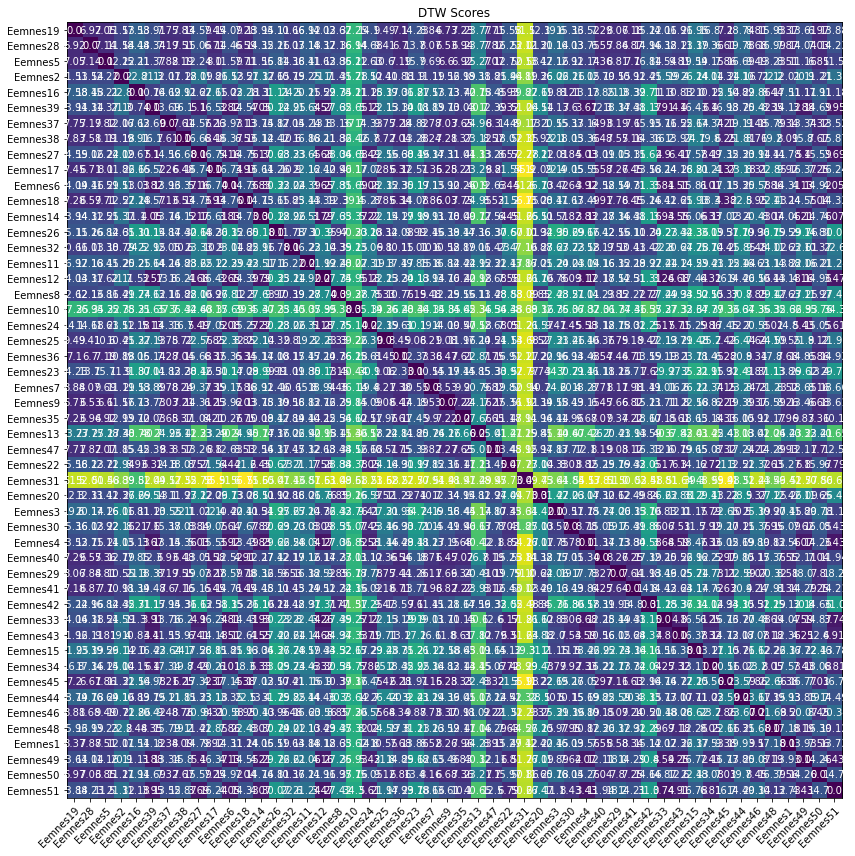

In [43]:
scores_df = dtw_scores(df)
scores_implot(scores_df)

<ipython-input-9-d0baa918c05f>:2: ClusterWarning:

scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix



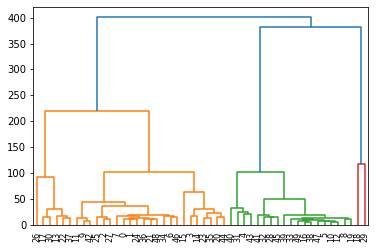

In [44]:
dendogram(scores_df)

In [88]:
cluster_membership, labels= agglomerative_clustering(df, scores_df, n=4)
cluster_membership

C:\Users\Zeeshan\anaconda3\envs\ileco_forecasting\lib\site-packages\scipy\cluster\hierarchy.py:834: ClusterWarning:

scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix



,Building,Cluster
29,Eemnes31,Cluster 0
18,Eemnes10,Cluster 0
0,Eemnes19,Cluster 1
46,Eemnes1,Cluster 1
44,Eemnes46,Cluster 1
42,Eemnes45,Cluster 1
36,Eemnes41,Cluster 1
35,Eemnes29,Cluster 1
34,Eemnes40,Cluster 1
27,Eemnes47,Cluster 1


## Clustering Plots

#### Cluster Distances

In [89]:
clusters_scatter_plot(scores_df, labels)